In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy
from statsmodels.graphics.mosaicplot import mosaic
from sklearn.preprocessing import MinMaxScaler

In [32]:
# Import data from source, convert to dataframe and clean data

# Import and convert to dataframe
df = pd.read_csv('./dataset/adult.data.txt', sep=", ", header=None)

# Define columns of the dataframe
df.columns = ["age", "workclass", "fnlwgt", "education", "education-num", "marital-status", "occupation","relationship", "race", "sex", "capital-gain", "capital-loss", "hours-per-week", "native-country", "salary-range"]

# Get rid of rows that contain "?"
df = df[df["workclass"] != '?']
df = df[df["education"] != '?']
df = df[df["marital-status"] != '?']
df = df[df["occupation"] != '?']
df = df[df["relationship"] != '?']
df = df[df["race"] != '?']
df = df[df["sex"] != '?']
df = df[df["native-country"] != '?']

# Sampling
below_50K = df[df["salary-range"] == "<=50K"].sample(n=7841)
above_50K = df[df["salary-range"] == ">50K"]

df = pd.concat([above_50K, below_50K])
df['class'] = (df["salary-range"] == ">50K")*1
df.head()

<ipython-input-32-515594abdc8e>:4: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  df = pd.read_csv('./dataset/adult.data.txt', sep=", ", header=None)


,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,salary-range,class
7,52,Self-emp-not-inc,209642,HS-grad,9,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,45,United-States,>50K,1
8,31,Private,45781,Masters,14,Never-married,Prof-specialty,Not-in-family,White,Female,14084,0,50,United-States,>50K,1
9,42,Private,159449,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,5178,0,40,United-States,>50K,1
10,37,Private,280464,Some-college,10,Married-civ-spouse,Exec-managerial,Husband,Black,Male,0,0,80,United-States,>50K,1
11,30,State-gov,141297,Bachelors,13,Married-civ-spouse,Prof-specialty,Husband,Asian-Pac-Islander,Male,0,0,40,India,>50K,1


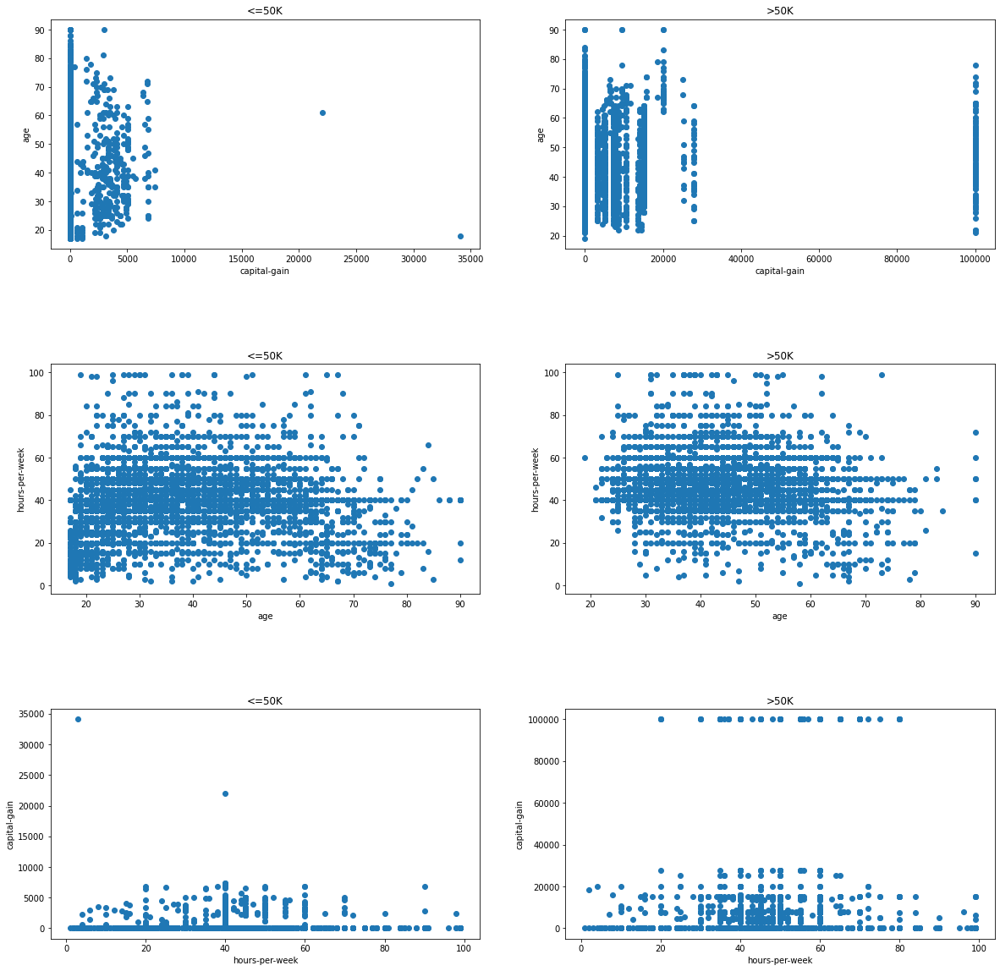

In [36]:
# 1. Scatter plot of Capital gain vs Age & hours/week vs Capital gain for <=50k & >50k income ranges

plt.close()

# plot
fig, axes = plt.subplots(ncols=2, nrows=3, figsize=(20,20))
fig.subplots_adjust(hspace=.5)
    
# <=50k Analysis
# Capital-gain vs Age plot
x = below_50K['capital-gain']
y = below_50K['age']
axes[0, 0].scatter(x,y)
axes[0, 0].set_title("<=50K")
axes[0, 0].set_xlabel('capital-gain')
axes[0, 0].set_ylabel('age')

# Age vs Hrs/week plot
x = below_50K['age']
y = below_50K['hours-per-week']
axes[1, 0].scatter(x,y)
axes[1, 0].set_title("<=50K")
axes[1, 0].set_xlabel('age')
axes[1, 0].set_ylabel('hours-per-week')

# Hrs/week vs capital-gain plot
x = below_50K['hours-per-week']
y = below_50K['capital-gain']
axes[2, 0].scatter(x,y)
axes[2, 0].set_title("<=50K")
axes[2, 0].set_xlabel('hours-per-week')
axes[2, 0].set_ylabel('capital-gain')

# >50k Analysis
# Capital-gain vs Age plot    
x = above_50K['capital-gain']
y = above_50K['age']
axes[0, 1].scatter(x,y)
axes[0, 1].set_title(">50K")
axes[0, 1].set_xlabel('capital-gain')
axes[0, 1].set_ylabel('age')
    
# Age vs Hrs/week plot    
x = above_50K['age']
y = above_50K['hours-per-week']
axes[1, 1].scatter(x,y)
axes[1, 1].set_title(">50K")
axes[1, 1].set_xlabel('age')
axes[1, 1].set_ylabel('hours-per-week')

# Hrs/week vs Capital-gain 
x = above_50K['hours-per-week']
y = above_50K['capital-gain']
axes[2, 1].scatter(x,y)
axes[2, 1].set_title(">50K")
axes[2, 1].set_xlabel('hours-per-week')
axes[2, 1].set_ylabel('capital-gain')
    
plt.show()

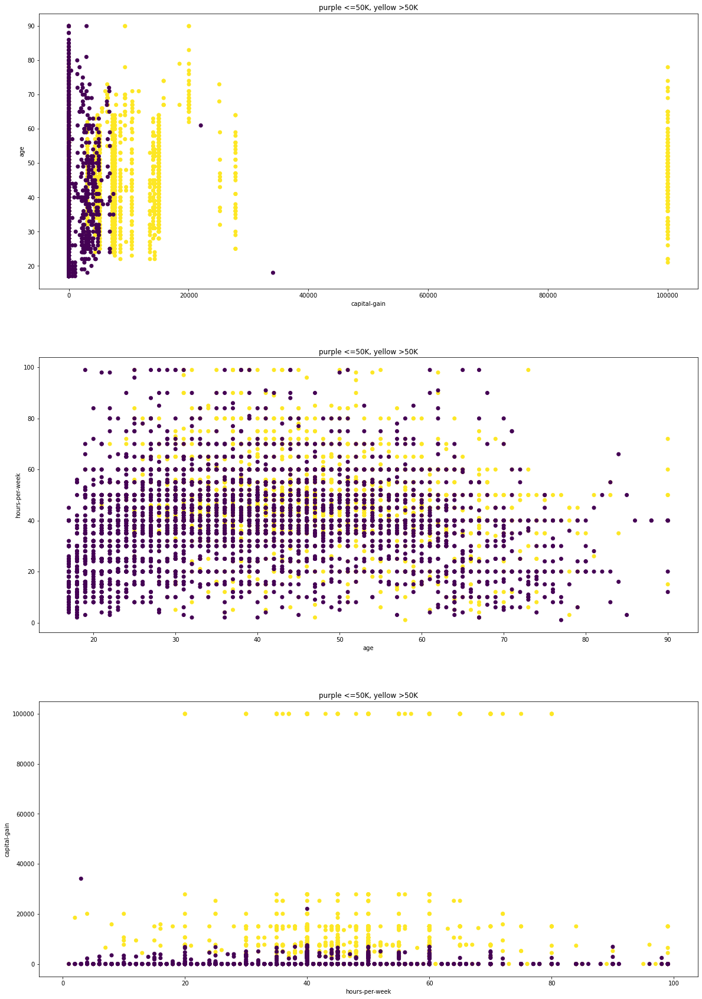

In [42]:
# 2. Combined scatter plots 

plt.close()
fig, axes = plt.subplots(ncols=1, nrows=3, figsize=(20,30))
fig.subplots_adjust(hspace=0.25)
colors = df['class']

# Capital gain vs Age plot
x = df['capital-gain']
y = df['age']
axes[0].scatter(x,y,c=colors)
axes[0].set_title("purple <=50K, yellow >50K")
axes[0].set_xlabel('capital-gain')
axes[0].set_ylabel('age')

# Age vs Hrs/Week plot
x = df['age']
y = df['hours-per-week']
axes[1].scatter(x,y,c=colors)
axes[1].set_title("purple <=50K, yellow >50K")
axes[1].set_xlabel('age')
axes[1].set_ylabel('hours-per-week')

# Hrs/week vs Capital-gain
x = df['hours-per-week']
y = df['capital-gain']
axes[2].scatter(x,y,c=colors)
axes[2].set_title("purple <=50K, yellow >50K")
axes[2].set_xlabel('hours-per-week')
axes[2].set_ylabel('capital-gain')
    
plt.show()

<ipython-input-46-3ce905f04dd7>:7: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  pd.plotting.scatter_matrix(df_below, ax=axes)


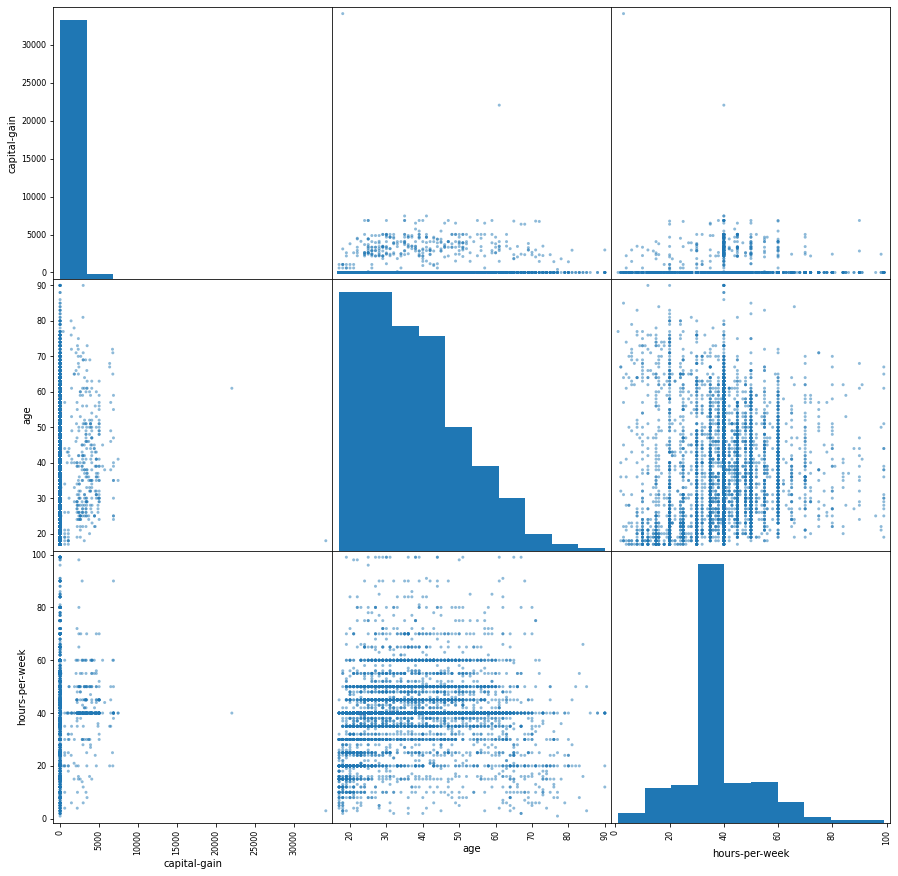

In [46]:
# 3. Scatter Matrix plot Analysis for <=50k range income keeping Capital gain, Age & Hrs/week as params
plt.close()
fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(15,15))
fig.subplots_adjust(hspace=.5)
# create dataframe for below 50k table with Capital gain, Age & Hrs/week
df_below = below_50K[['capital-gain', 'age', 'hours-per-week']]
pd.plotting.scatter_matrix(df_below, ax=axes)
plt.show()

<ipython-input-47-815bbe0ccbf2>:7: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  pd.plotting.scatter_matrix(df_above, ax=axes)


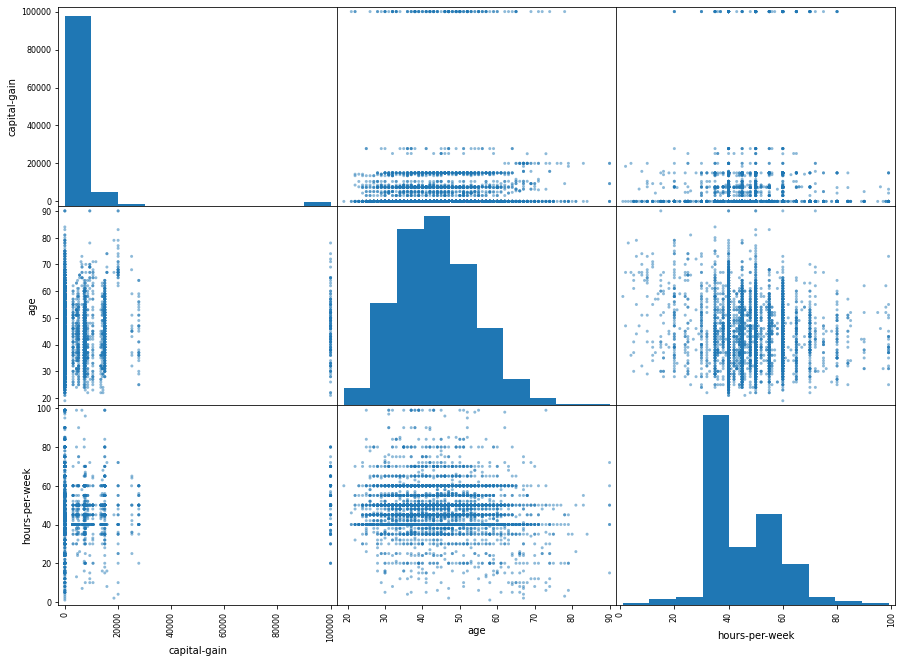

In [47]:
# 4. Scatter Matrix plot Analysis for <=50k range income keeping Capital gain, Age & Hrs/week as params
plt.close()
fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(15,11))
fig.subplots_adjust(hspace=.5)
# create dataframe for below 50k table with Capital gain, Age & Hrs/week
df_above = above_50K[[column1, column2, column3]]
pd.plotting.scatter_matrix(df_above, ax=axes)
plt.show()

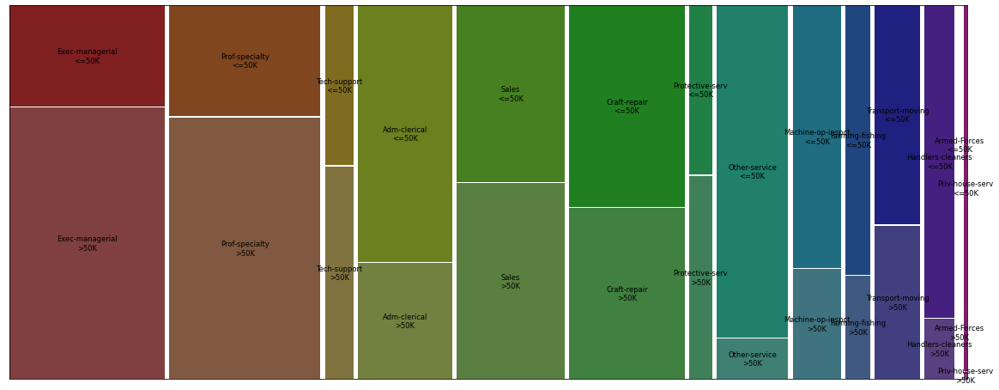

In [54]:
# 5. Mosaic plot of Occupation vs Salary range
plt.close()
fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(20,8))
fig.subplots_adjust(hspace=.5)
mosaic(df, ['occupation', 'salary-range'], ax=axes, ax)
plt.show()

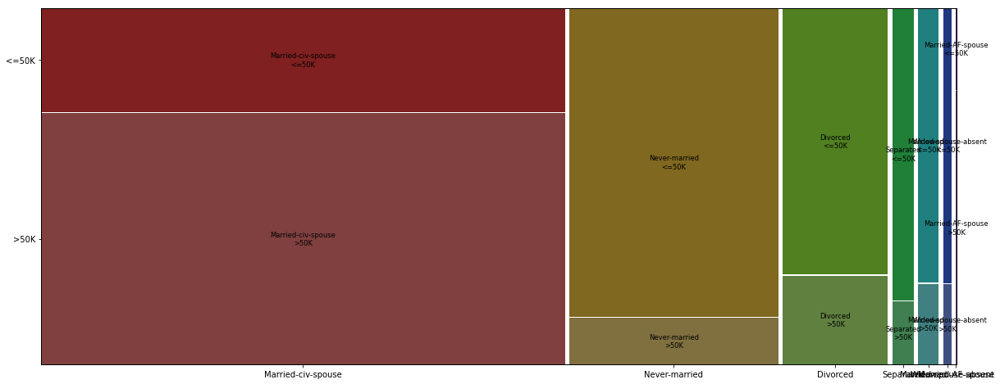

In [64]:
# 6. Mosaic plot of Marital-status vs Salary-ran
plt.close()
fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(20,8))
fig.subplots_adjust(hspace=.5)
mosaic(df, ['marital-status', 'salary-range'], ax=axes)
plt.show()

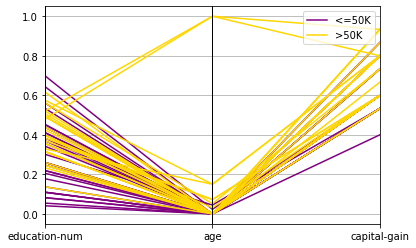

In [69]:
# 7. Parallel coordinates plot with education-num, Age and Capital-gain as params 

# create dataframe 
df_pc = df[['education-num', 'age', 'capital-gain', 'class']].copy()
df_pc_np_array = MinMaxScaler().fit_transform(df_pc.values)
df_pc = pd.DataFrame(df_pc_np_array)
df.index = df_pc.index
df_pc['salary-range'] = df['salary-range']
df_pc.columns = ['capital-gain', 'education-num', 'age', 'class', 'salary-range']
df_pc_below_50K = df_pc[df_pc["class"] == 0.0].sample(n=30)
df_pc_above_50K = df_pc[df_pc["class"] == 1.0].sample(n=30)
df_pc = pd.concat([df_pc_below_50K, df_pc_above_50K])

# plot
pd.plotting.parallel_coordinates(df_pc, 'salary-range', cols=['education-num', 'age', 'capital-gain'], color=('#800080', '#ffd700'))
plt.show()

Salary <=50K


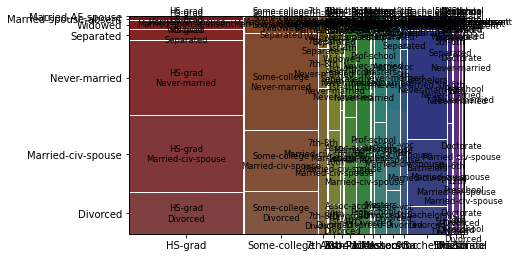

Salary >50K


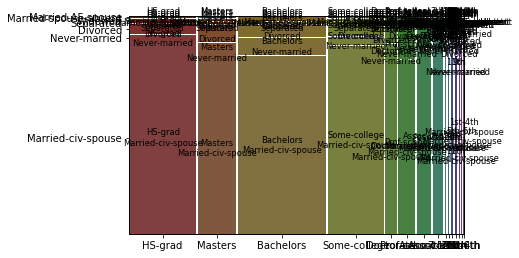

Salary <=50K


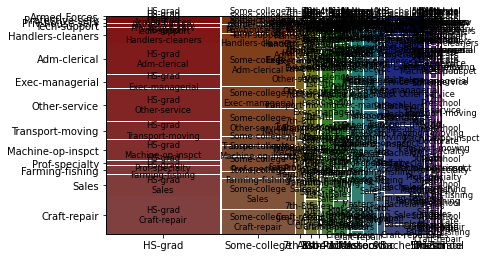

Salary >50K


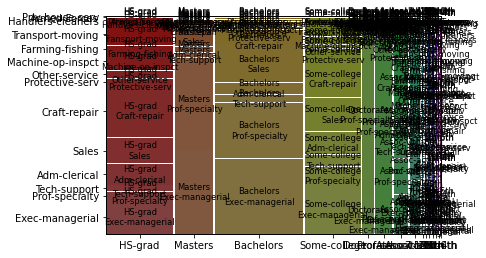

Salary <=50K


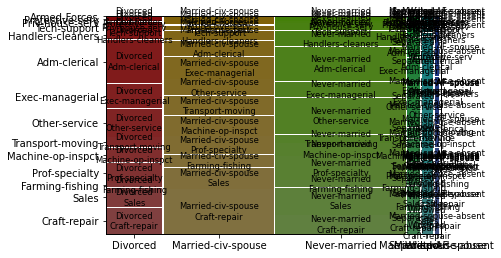

Salary >50K


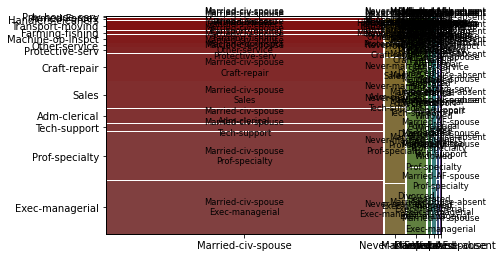

Salary <=50K


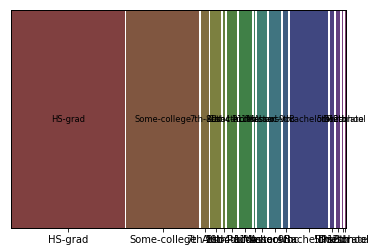

Salary >50K


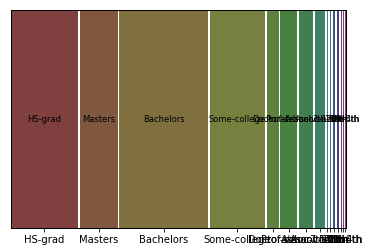

Salary <=50K


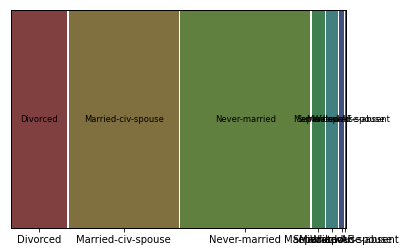

Salary >50K


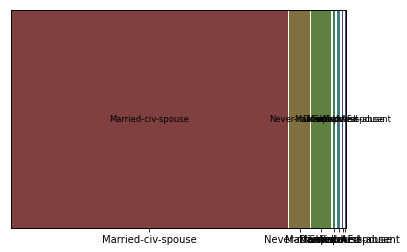

Salary <=50K


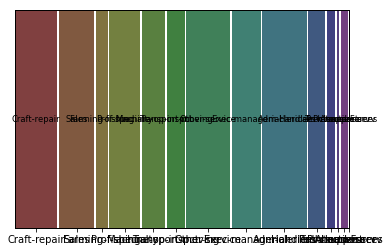

Salary >50K


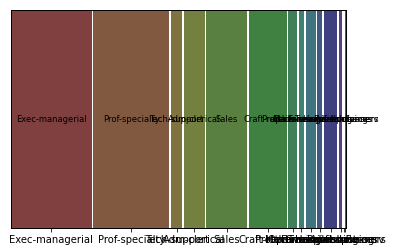

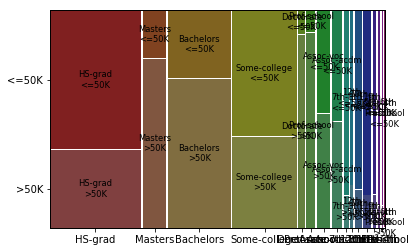

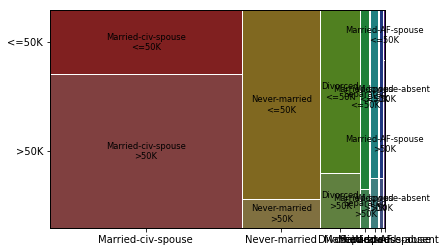

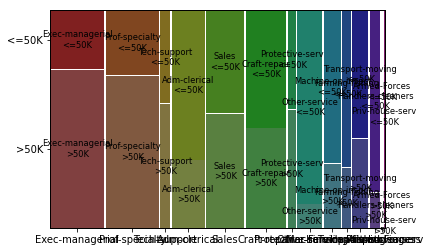

In [77]:
# 8. Mosaic plot of education, marital-status and occupation 
plt.close()
cols = ['education', 'marital-status', 'occupation']
for i in range(3):
    for j in range(i+1, 3):
        print("Salary <=50K")
        mosaic(below_50K, [cols[i], cols[j]])
        plt.show()
        print("Salary >50K")
        mosaic(above_50K, [cols[i], cols[j]])
        plt.show()
for i in range(3):
    print("Salary <=50K")
    mosaic(below_50K, [cols[i]])
    plt.show()
    print("Salary >50K")
    mosaic(above_50K, [cols[i]])
    plt.show()
for i in range(3):
    mosaic(df, [cols[i], 'salary-range'])
    plt.show()